<a href="https://colab.research.google.com/github/shadenalsahli/PP-YOLO/blob/main/PP_YOLO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Install PaddlePaddle**

In [ ]:
!python -m pip install paddlepaddle-gpu==2.2.2.post101 -f https://www.paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html

Looking in links: https://www.paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html
     |████████████████████████████████| 434.3 MB 14 kB/s 


# **2. Check paddle installation**

In [ ]:
import paddle
!python -c "import paddle; print(paddle.__version__)"

2.2.2


# **3. Install PaddleDetection**

In [ ]:
# Clone PaddleDetection repository
!git clone https://github.com/PaddlePaddle/PaddleDetection.git

%cd /content/PaddleDetection

# Install other dependencies
!pip install -r requirements.txt

# Compile and install paddledet
!python setup.py install

Cloning into 'PaddleDetection'...
remote: Enumerating objects: 22528, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 22528 (delta 6), reused 9 (delta 4), pack-reused 22509
Receiving objects: 100% (22528/22528), 263.65 MiB | 62.87 MiB/s, done.
Resolving deltas: 100% (16457/16457), done.
Checking out files: 100% (1861/1861), done.
/content/PaddleDetection
     |████████████████████████████████| 2.7 MB 5.2 MB/s 
     |████████████████████████████████| 1.5 MB 87.3 MB/s 
     |████████████████████████████████| 161 kB 48.0 MB/s 
     |████████████████████████████████| 127 kB 78.7 MB/s 
     |████████████████████████████████| 2.1 MB 50.5 MB/s 
     |████████████████████████████████| 64 kB 3.6 MB/s 
     |████████████████████████████████| 197 kB 101.1 MB/s 
     |████████████████████████████████| 42 kB 1.1 MB/s 
     |████████████████████████████████| 69 kB 9.6 MB/s 
     |████████████████████████████████| 2.0 MB 89.1 MB/s 
  

# **4. Check if PaddleDetection works**

In [ ]:
!python ppdet/modeling/tests/test_architectures.py

/usr/local/lib/python3.7/dist-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:
/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silenc

# **5. Download dataset**

In [ ]:
from google.colab import files
from google.colab import drive
#mount drive
%cd ..
#from google.colab import drive
drive.mount('/content/gdrive')

# this creates a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
!ln -s /content/gdrive/My\ Drive/ /mydrive

!unzip /mydrive/BCCD.zip -d /content/

/content
Mounted at /content/gdrive
Archive:  /mydrive/BCCD.zip
   creating: /content/BCCD/
  inflating: /content/__MACOSX/._BCCD  
  inflating: /content/BCCD/README.roboflow.txt  
  inflating: /content/__MACOSX/BCCD/._README.roboflow.txt  
   creating: /content/BCCD/valid/
  inflating: /content/__MACOSX/BCCD/._valid  
  inflating: /content/BCCD/README.dataset.txt  
  inflating: /content/__MACOSX/BCCD/._README.dataset.txt  
  inflating: /content/BCCD/.DS_Store  
  inflating: /content/__MACOSX/BCCD/._.DS_Store  
   creating: /content/BCCD/test/
  inflating: /content/__MACOSX/BCCD/._test  
   creating: /content/BCCD/train/
  inflating: /content/__MACOSX/BCCD/._train  
  inflating: /content/BCCD/valid/BloodImage_00377_jpg.rf.0c8524be5de7a9ef2d1faa43043e0fe9.jpg  
  inflating: /content/__MACOSX/BCCD/valid/._BloodImage_00377_jpg.rf.0c8524be5de7a9ef2d1faa43043e0fe9.jpg  
  inflating: /content/BCCD/valid/BloodImage_00228_jpg.rf.04ee883d828bddd9a8ec6b54591c3d66.jpg  
  inflating: /content/__MA

# **6. Write custom configuration**
By slotting our dataset, training parameters...

1. *Slotting the dataset*

In [ ]:
# Setting the variables
num_classes=3
dataset_dir="/content/BCCD"
train_image_dir="/content/BCCD/train"
train_anno_path="/content/BCCD/train/_annotations.coco.json"
valid_image_dir="/content/BCCD/valid"
valid_anno_path="/content/BCCD/valid/_annotations.coco.json"
test_anno_path="/content/BCCD/test/_annotations.coco.json"

import re

%cd /content/PaddleDetection/configs/datasets

with open('/content/PaddleDetection/configs/datasets/coco_detection.yml') as f:
    s = f.read()
with open('coco_detection.yml', 'w') as f:
    
    # Set number of classes num_classes
    s = re.sub('num_classes: [0-9]+','num_classes: {}'.format(num_classes), s)

    # Set dataset, images directories and annotation path
    s = re.sub('dataset_dir: .*', 'dataset_dir: {}'.format(dataset_dir), s)

    s = re.sub('anno_path: .*', 
               'anno_path: {}'.format(test_anno_path), s,3)
    
    s = re.sub('image_dir: .*', 
               'image_dir: {}'.format(valid_image_dir), s,2)
    
    s = re.sub('anno_path: .*', 
               'anno_path: {}'.format(valid_anno_path), s,2)
    
    s = re.sub('image_dir: .*', 
               'image_dir: {}'.format(train_image_dir), s,1)
    
    s = re.sub('anno_path: .*', 
               'anno_path: {}'.format(train_anno_path), s,1)
    
    f.write(s)

    f.close

/content/PaddleDetection/configs/datasets


In [ ]:
# Print the config. to ensure the writing is done successfully
%cat /content/PaddleDetection/configs/datasets/coco_detection.yml

metric: COCO
num_classes: 3

TrainDataset:
  !COCODataSet
    image_dir: /content/BCCD/train
    anno_path: /content/BCCD/train/_annotations.coco.json
    dataset_dir: /content/BCCD
    data_fields: ['image', 'gt_bbox', 'gt_class', 'is_crowd']

EvalDataset:
  !COCODataSet
    image_dir: /content/BCCD/valid
    anno_path: /content/BCCD/valid/_annotations.coco.json
    dataset_dir: /content/BCCD

TestDataset:
  !ImageFolder
    anno_path: /content/BCCD/test/_annotations.coco.json
    dataset_dir: /content/BCCD


2. *Set the batch size on tarining phase*

In [ ]:
# Setting the variables
batch_size=10

import re

%cd /content/PaddleDetection/configs/ppyolo/_base_

with open('/content/PaddleDetection/configs/ppyolo/_base_/ppyolo_reader.yml') as f:
    s = f.read()
with open('ppyolo_reader.yml', 'w') as f:
    
    # Set number of batch size
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s,1)
    
    f.write(s)

    f.close

/content/PaddleDetection/configs/ppyolo/_base_


In [ ]:
# Print the config. to ensure the writing is done successfully
%cat /content/PaddleDetection/configs/ppyolo/_base_/ppyolo_reader.yml

worker_num: 2
TrainReader:
  inputs_def:
    num_max_boxes: 50
  sample_transforms:
    - Decode: {}
    - Mixup: {alpha: 1.5, beta: 1.5}
    - RandomDistort: {}
    - RandomExpand: {fill_value: [123.675, 116.28, 103.53]}
    - RandomCrop: {}
    - RandomFlip: {}
  batch_transforms:
    - BatchRandomResize: {target_size: [320, 352, 384, 416, 448, 480, 512, 544, 576, 608], random_size: True, random_interp: True, keep_ratio: False}
    - NormalizeBox: {}
    - PadBox: {num_max_boxes: 50}
    - BboxXYXY2XYWH: {}
    - NormalizeImage: {mean: [0.485, 0.456, 0.406], std: [0.229, 0.224, 0.225], is_scale: True}
    - Permute: {}
    - Gt2YoloTarget: {anchor_masks: [[6, 7, 8], [3, 4, 5], [0, 1, 2]], anchors: [[10, 13], [16, 30], [33, 23], [30, 61], [62, 45], [59, 119], [116, 90], [156, 198], [373, 326]], downsample_ratios: [32, 16, 8]}
  batch_size: 10
  shuffle: true
  drop_last: true
  mixup_epoch: 25000
  use_shared_memory: true

EvalReader:
  sample_transforms:
    - Decode: {}
    - Resize


3. *Configure the optmizier*

In [ ]:
# Setting the variables
epochs=300
learning_rate=0.00125

import re

%cd /content/PaddleDetection/configs/ppyolo/_base_

with open('/content/PaddleDetection/configs/ppyolo/_base_/optimizer_1x.yml') as f:
    s = f.read()
with open('optimizer_1x.yml', 'w') as f:
    
    # Set number of epochs
    s = re.sub('epoch: [0-9]+',
               'epoch: {}'.format(epochs), s,1)
    
     # Set lr
    s = re.sub('base_lr: 0.[0-9]+',
               'base_lr: {}'.format(learning_rate), s,1)
    
    f.write(s)

    f.close

/content/PaddleDetection/configs/ppyolo/_base_


In [ ]:
# Print the config. to ensure the writing is done successfully
%cat /content/PaddleDetection/configs/ppyolo/_base_/optimizer_1x.yml

epoch: 300

LearningRate:
  base_lr: 0.00125
  schedulers:
  - !PiecewiseDecay
    gamma: 0.1
    milestones:
    - 243
    - 324
  - !LinearWarmup
    start_factor: 0.
    steps: 4000

OptimizerBuilder:
  optimizer:
    momentum: 0.9
    type: Momentum
  regularizer:
    factor: 0.0005
    type: L2


*4. Set the snapshot*

In [ ]:
# Setting the variables
snapshot_epoch=30

import re

%cd /content/PaddleDetection/configs/ppyolo

with open('/content/PaddleDetection/configs/ppyolo/ppyolo_r50vd_dcn_1x_coco.yml') as f:
    s = f.read()
with open('ppyolo_r50vd_dcn_1x_coco.yml', 'w') as f:
    
    # Set snapshot
    s = re.sub('snapshot_epoch: [0-9]+',
               'snapshot_epoch: {}'.format(snapshot_epoch), s,1)
    
    f.write(s)

    f.close

/content/PaddleDetection/configs/ppyolo


In [ ]:
# Print the config. to ensure the writing is done successfully
%cat /content/PaddleDetection/configs/ppyolo/ppyolo_r50vd_dcn_1x_coco.yml

_BASE_: [
  '../datasets/coco_detection.yml',
  '../runtime.yml',
  './_base_/ppyolo_r50vd_dcn.yml',
  './_base_/optimizer_1x.yml',
  './_base_/ppyolo_reader.yml',
]

snapshot_epoch: 30
weights: output/ppyolo_r50vd_dcn_1x_coco/model_final


In [ ]:
%cd /content

/content


# **7. Training**

In [ ]:
!export CUDA_VISIBLE_DEVICES=0
!python /content/PaddleDetection/tools/train.py -c /content/PaddleDetection/configs/ppyolo/ppyolo_r50vd_dcn_1x_coco.yml -o pretrain_weights=https://paddledet.bj.bcebos.com/models/ppyolo_r50vd_dcn_1x_coco.pdparams --eval

/usr/local/lib/python3.7/dist-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:
/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silenc

# **8. Evaluation**

In [ ]:
!pip uninstall opencv-python-headless 
!pip install opencv-python-headless==4.1.2.30

Found existing installation: opencv-python-headless 4.5.5.64
Uninstalling opencv-python-headless-4.5.5.64:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless-4.5.5.64.dist-info/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavcodec-65fa80df.so.58.134.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavformat-8ef5c7db.so.58.76.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavutil-9c768859.so.56.70.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libbz2-a273e504.so.1.0.6
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libcrypto-09fe7800.so.1.1
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libgfortran-91cc3cb1.so.3.0.0
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libopenblas-r0-f650aae0.3.3.so
    /usr/local/lib/python3.7/dis

In [ ]:
!export CUDA_VISIBLE_DEVICES=0
!python /content/PaddleDetection/tools/eval.py -c /content/PaddleDetection/configs/ppyolo/ppyolo_r50vd_dcn_1x_coco.yml -o weights=/content/output/ppyolo_r50vd_dcn_1x_coco/best_model.pdparams
#model_final

/usr/local/lib/python3.7/dist-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:
/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silenc

# **9. Inference (images output)**

In [ ]:
!export CUDA_VISIBLE_DEVICES=0
!python /content/PaddleDetection/tools/infer.py -c /content/PaddleDetection/configs/ppyolo/ppyolo_r50vd_dcn_1x_coco.yml -o use_gpu=true weights=/content/output/ppyolo_r50vd_dcn_1x_coco/best_model.pdparams --infer_dir=/content/BCCD/valid

/usr/local/lib/python3.7/dist-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:
/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silenc

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3327, done.
remote: Counting objects: 100% (3327/3327), done.
remote: Compressing objects: 100% (2750/2750), done.
remote: Total 3327 (delta 883), reused 1394 (delta 527), pack-reused 0
Receiving objects: 100% (3327/3327), 34.30 MiB | 34.57 MiB/s, done.
Resolving deltas: 100% (883/883), done.


In [ ]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1690985 sha256=ed006984396268f4294b20ab6112ef34ce62a92a94e2a111d6e83e1c2d9c0b28
  Stored in directory: /tmp/pip-ephem-wheel-cache-x4nkrnjp/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=b69c0efb623acd091f8dd2f6e5985cd92366f0eccc51b305a7e0ac8cd76baad6
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=a0b79331bd89dcfd4ad47b786ad232ec0d323516da8902c145c84306b1c51bb1
  Stored in directory: /root/.cache/pip/wheels/a4/61/fd/c57e374e580aa78a45ed78d5859b3a44436af17e22ca53284f
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44010 sha256=485f0f1e3d5ca24af919577c4390b3066aefd0a02cb3668bfd

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
flake8 4.0.1 requires importlib-metadata<4.3; python_version < "3.8", but you have importlib-metadata 4.11.3 which is incompatible.
data

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecati

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

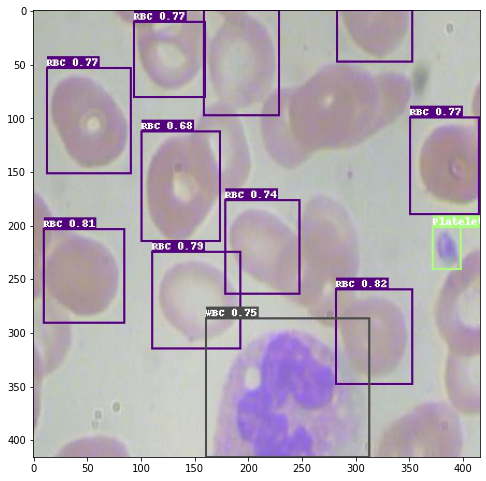

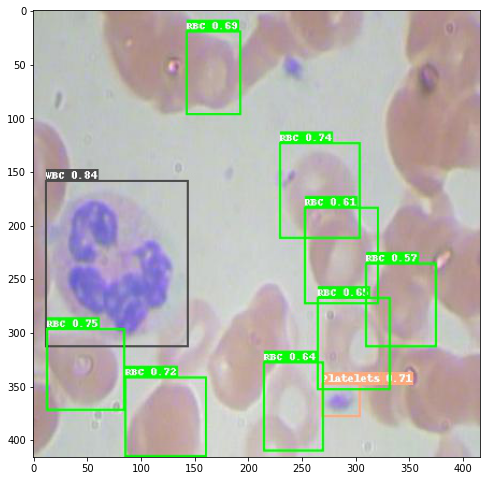

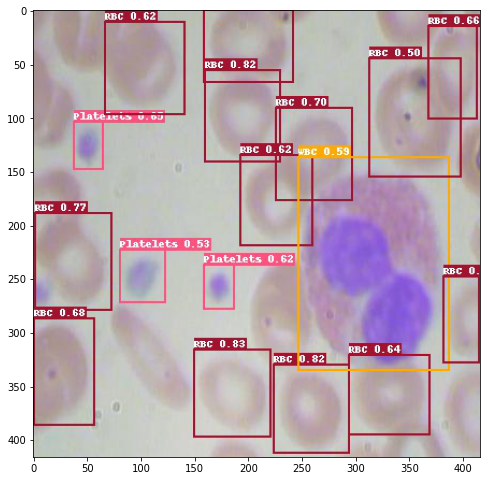

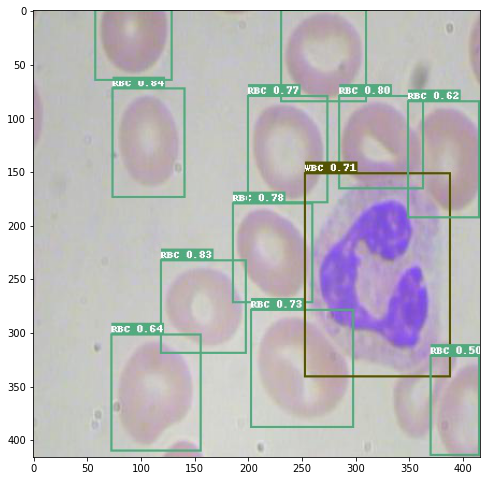

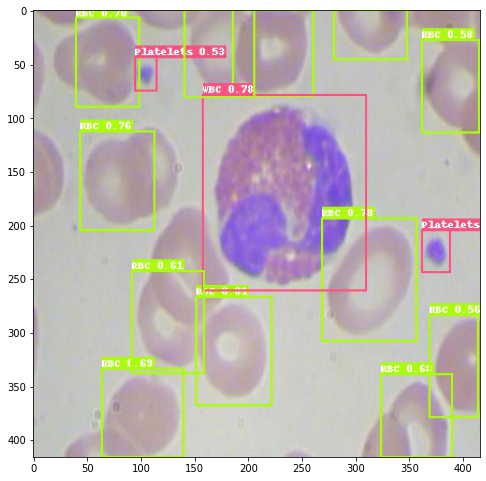

...

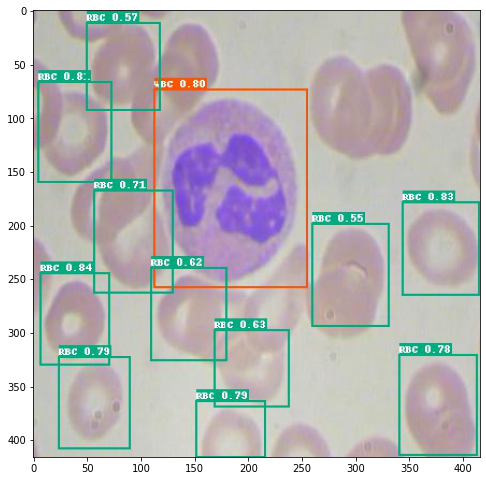

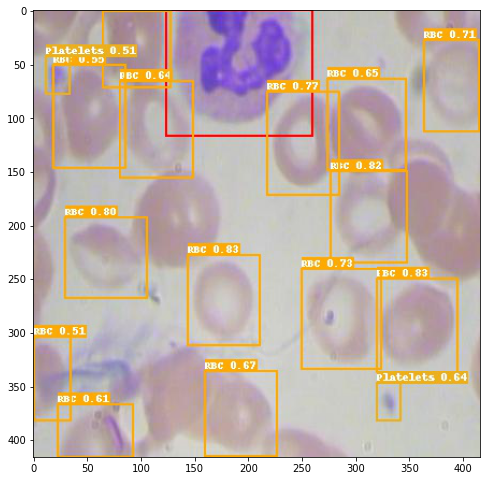

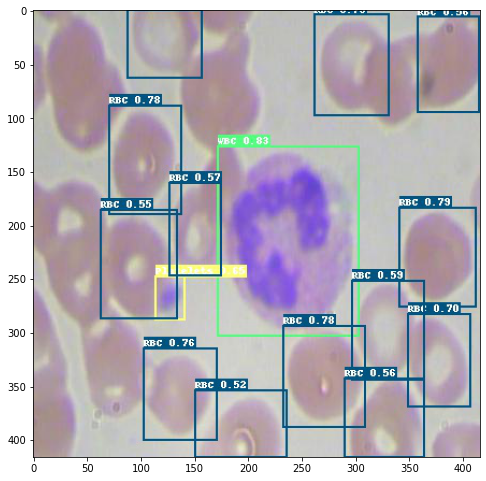

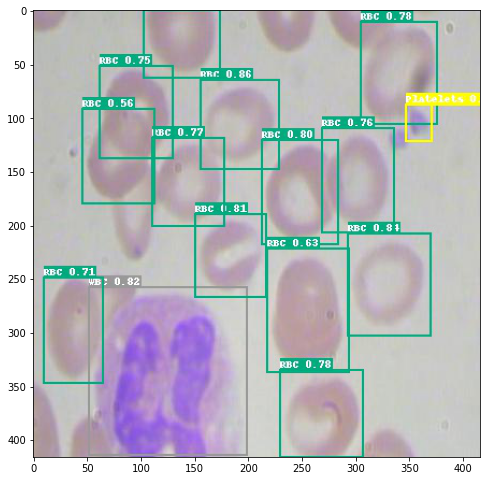

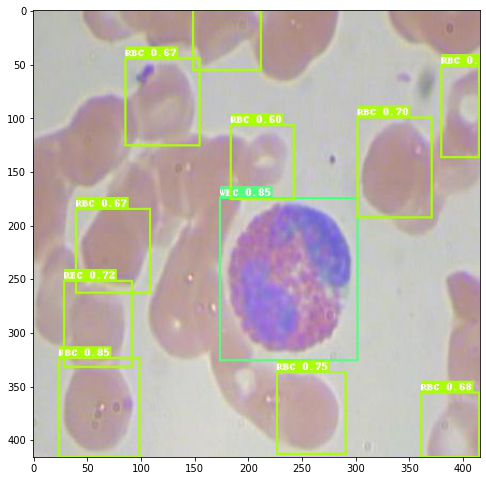

In [ ]:
import glob 

TEST_IMAGE_PATHS = glob.glob('/content/output/*.jpg')

for image_np in TEST_IMAGE_PATHS:

  image_np = load_image_into_numpy_array(image_np)

  plt.figure(figsize=(8,12))
  plt.imshow(image_np)
  plt.show()